In [8]:
from __future__ import print_function
import argparse
import torch
import torch.utils.data
from torch import nn, optim
from torch.nn import functional as F
from torchvision import datasets, transforms
from torchvision.utils import save_image
from read_data import read_data
from ggplot import ggplot, aes, geom_point, ggtitle
import numpy as np
from sklearn.manifold import TSNE
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors
from IPython.display import Image
import os


class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        self.input_size  = 784
        self.encoding_vector_size  = 2

        self.fc1 = nn.Linear(self.input_size, 400)
        self.fc21 = nn.Linear(400, self.encoding_vector_size)
        self.fc22 = nn.Linear(400, self.encoding_vector_size)
        self.fc3 = nn.Linear(self.encoding_vector_size, 400)
        self.fc4 = nn.Linear(400, self.input_size)

    def encode(self, x):
        h1 = F.relu(self.fc1(x))
        return self.fc21(h1), self.fc22(h1)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z):
        h3 = F.relu(self.fc3(z))
        return torch.sigmoid(self.fc4(h3))

    def forward(self, x):
        mu, logvar = self.encode(x.view(-1, 784))
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar, z


In [4]:
def decode_given_z(z,name,nrow):
    with torch.no_grad():
        sample = z.to(device)
        sample = model.decode(sample).cpu()
        save_image(sample.view(len(z), 1, 28, 28),'results/fashion-mnist/savedmodel_sample_'+name+'.png',nrow=nrow)
        return sample
        

In [3]:
def visualize_results(samples,labels,result_file,epoch):

    if not os.path.exists(str('8gaussians')+"tsne-vae"+ '/' + '8gaussians/'+result_file):
        os.makedirs(str('8gaussians')+"tsne-vae"+ '/' + '8gaussians/'+result_file)
    plt.clf()
    path=str('8gaussians') + "tsne-vae" + '/' + '8gaussians/'+result_file+'/' + '_epoch%03d' % epoch + '.png'
    plt.scatter(samples[:,0],samples[:,1],c=samples[:,0])
    plt.savefig(path)


In [4]:
decode_given_z()

TypeError: decode_given_z() missing 3 required positional arguments: 'z', 'name', and 'nrow'

In [ ]:
indexes=[]
for i in np.arange(-4,4,0.5):
    for j in np.arange(-4,4,0.5):
        indexes.append([float(i),float(j)])

***
### No missing label

In [92]:
model = VAE()
model.load_state_dict(torch.load('model_normal.pt'))
device = torch.device("cpu")

In [98]:
decode_given_z(torch.tensor(indexes),'normal',int(np.sqrt(len(indexes))))

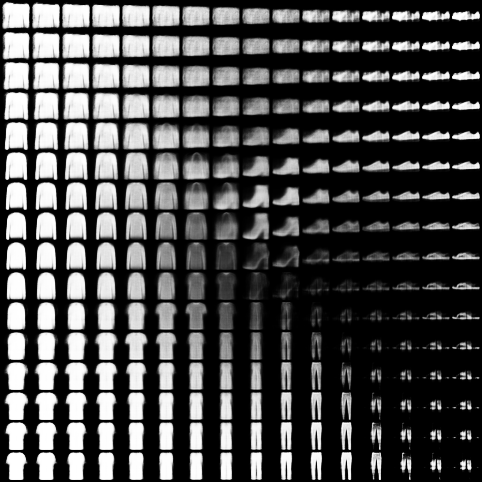

In [99]:
Image(filename='results/fashion-mnist/savedmodel_sample_normal.png') 

***
### TROUSERS MISSING

In [11]:
model = VAE()
model.load_state_dict(torch.load('model_missing_label_1.pt'))
device = torch.device("cpu")


In [90]:
decode_given_z(torch.tensor(indexes),'matrix',int(np.sqrt(len(indexes))))

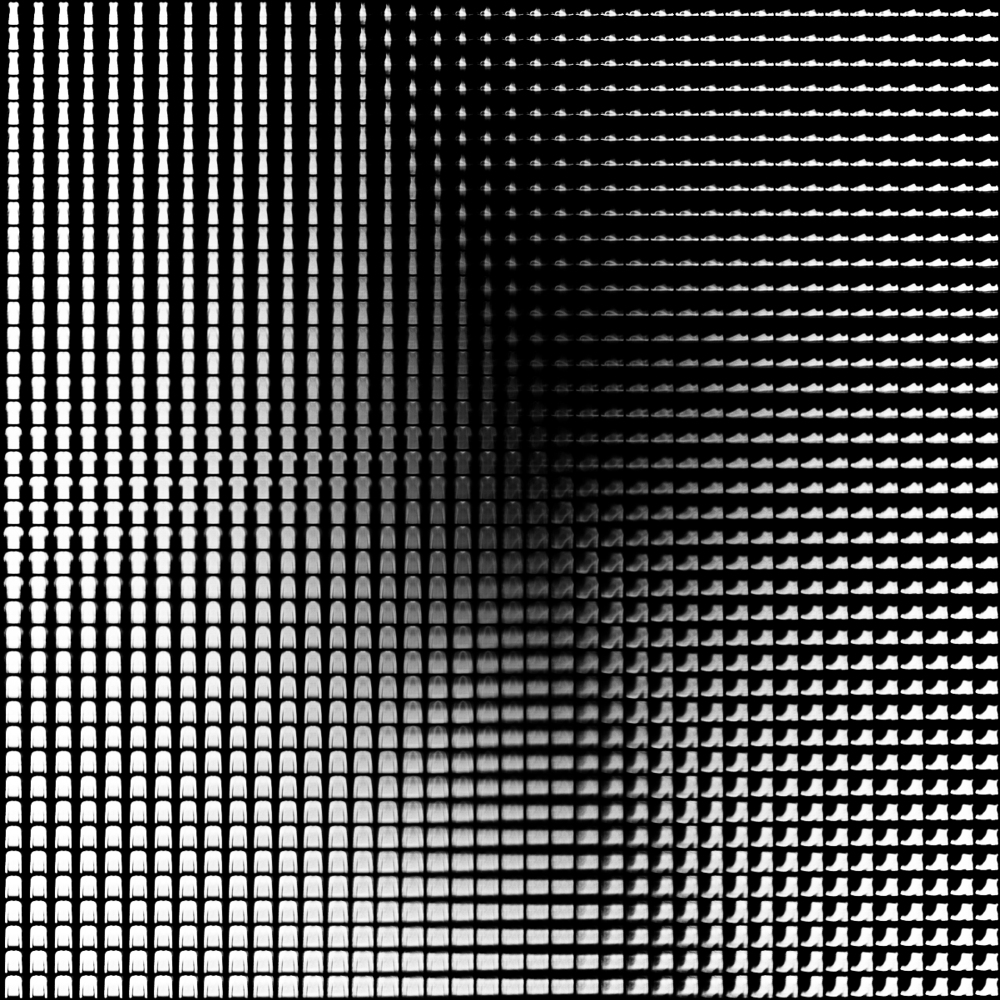

In [91]:
Image(filename='results/fashion-mnist/savedmodel_sample_matrix.png') 

***
### TROUSERS ONE SHOT SETTING

In [3]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_oneshot_missing.pt'))
device = torch.device("cpu")


In [4]:
indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

In [5]:
decode_given_z(torch.tensor(indexes),'trousers-oneshot',int(np.sqrt(len(indexes))))

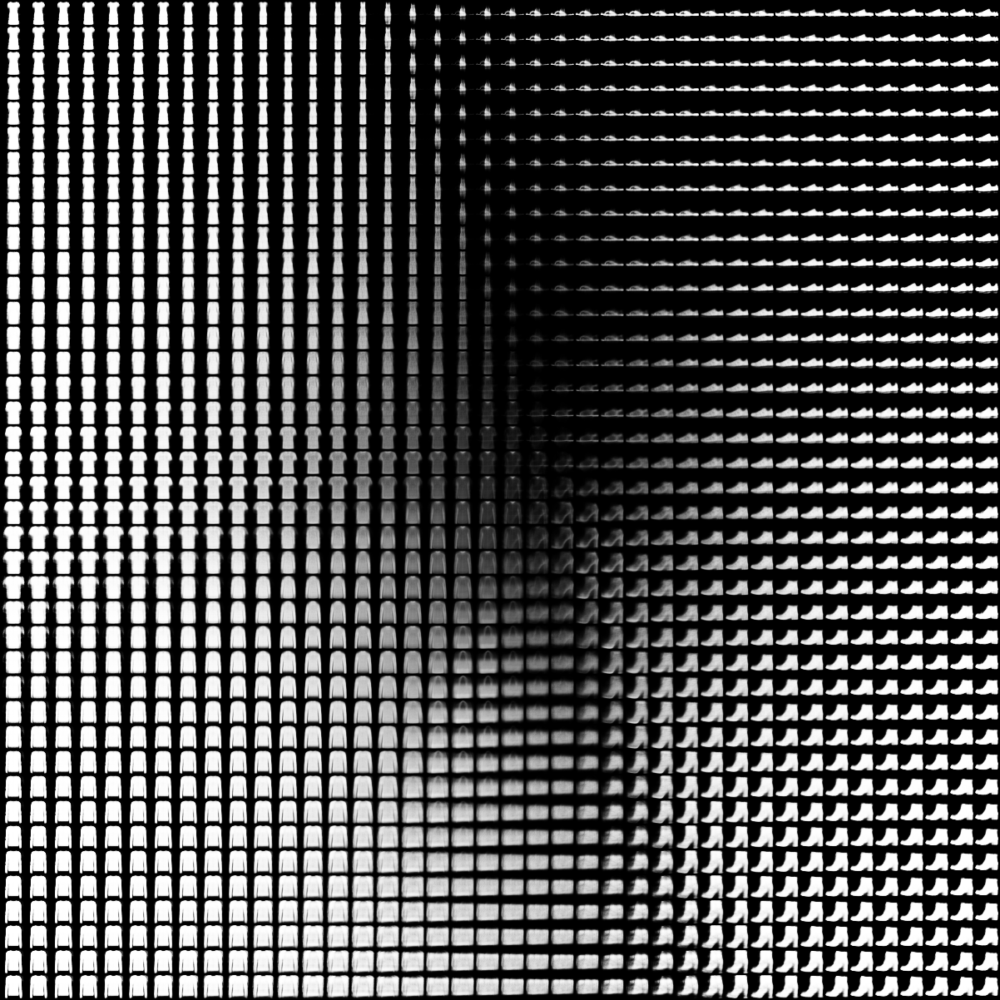

In [6]:
Image(filename='results/fashion-mnist/savedmodel_sample_trousers-oneshot.png') 

***
### TROUSERS FEW SHOT SETTING

In [7]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_fewshot_missing.pt'))
device = torch.device("cpu")

In [8]:
indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

In [11]:
decode_given_z(torch.tensor(indexes),'trousers-fewshot',int(np.sqrt(len(indexes))))

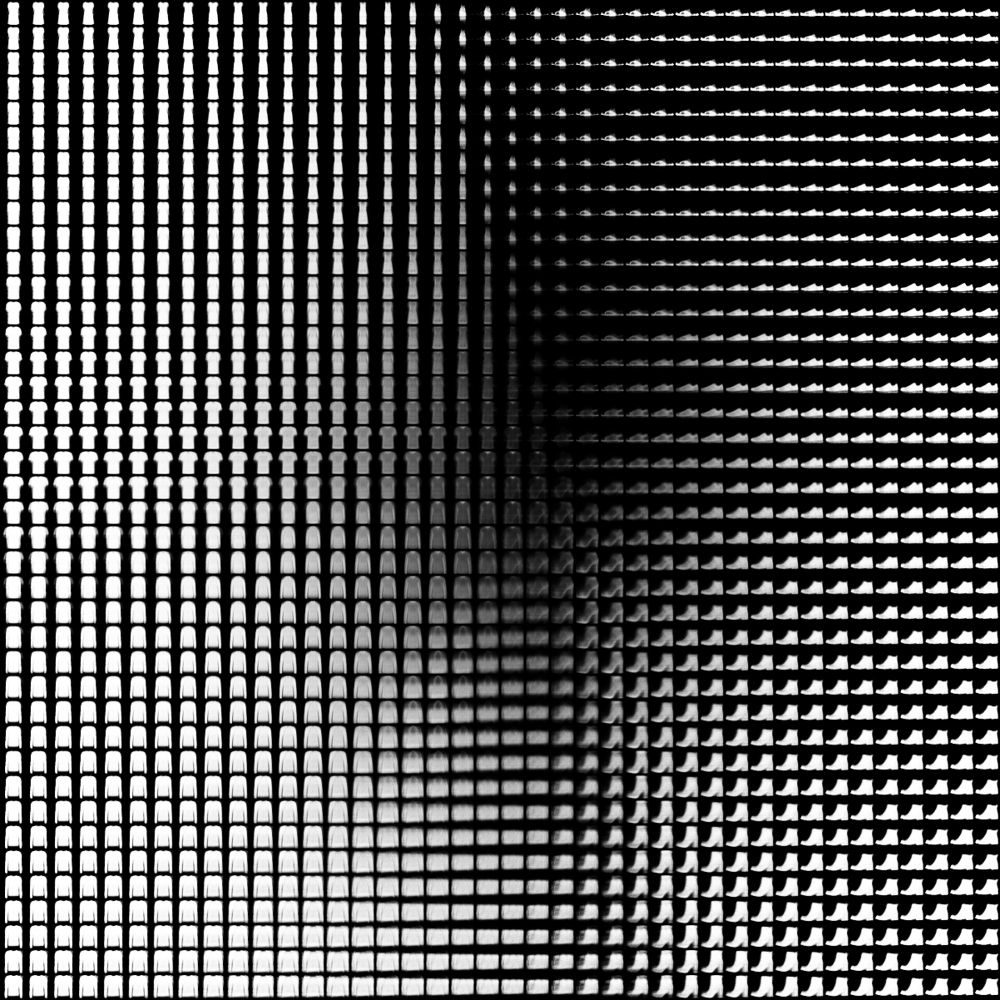

In [12]:
Image(filename='results/fashion-mnist/savedmodel_sample_trousers-fewshot.png') 

***
### SNEAKERS MISSING

In [19]:
model = VAE()
model.load_state_dict(torch.load('model_sneakers_missing.pt'))
device = torch.device("cpu")

RuntimeError: Error(s) in loading state_dict for VAE:
	size mismatch for fc1.weight: copying a param with shape torch.Size([400, 784]) from checkpoint, the shape in current model is torch.Size([400, 2]).
	size mismatch for fc21.bias: copying a param with shape torch.Size([2]) from checkpoint, the shape in current model is torch.Size([1]).
	size mismatch for fc21.weight: copying a param with shape torch.Size([2, 400]) from checkpoint, the shape in current model is torch.Size([1, 400]).
	size mismatch for fc22.bias: copying a param with shape torch.Size([2]) from checkpoint, the shape in current model is torch.Size([1]).
	size mismatch for fc22.weight: copying a param with shape torch.Size([2, 400]) from checkpoint, the shape in current model is torch.Size([1, 400]).
	size mismatch for fc3.weight: copying a param with shape torch.Size([400, 2]) from checkpoint, the shape in current model is torch.Size([400, 1]).
	size mismatch for fc4.bias: copying a param with shape torch.Size([784]) from checkpoint, the shape in current model is torch.Size([2]).
	size mismatch for fc4.weight: copying a param with shape torch.Size([784, 400]) from checkpoint, the shape in current model is torch.Size([2, 400]).

In [110]:
indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

In [111]:
decode_given_z(torch.tensor(indexes),'sneakers',int(np.sqrt(len(indexes))))

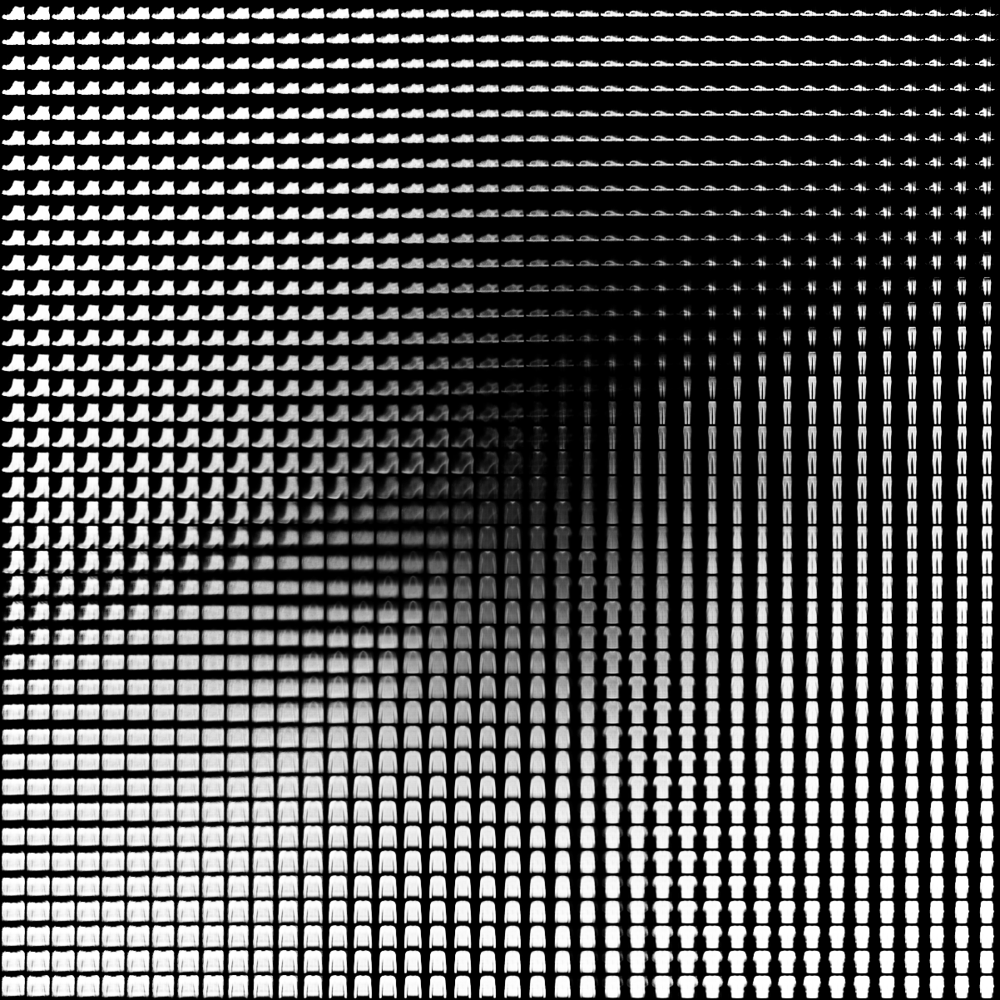

In [112]:
Image(filename='results/fashion-mnist/savedmodel_sample_sneakers.png') 

***
### 8 Gaussians

In [70]:
model = VAE()
model.load_state_dict(torch.load('8-gaussians.pt'))
device = torch.device("cpu")

In [104]:
indexes=[]
for i in np.arange(-5,5,0.01):
        indexes.append([float(i)])
a=torch.randn(64,1)

In [105]:
samples=decode_given_z(torch.tensor(indexes),'8',int(np.sqrt(len(indexes))))

In [111]:
visualize_results(samples,[0]*len(indexes),'manually',0)

In [112]:
samples

tensor([[4.1560e-39, 4.1560e-39],
        [4.1560e-39, 4.1560e-39],
        [4.1560e-39, 4.1560e-39],
        ...,
        [4.1560e-39, 1.0000e+00],
        [4.1560e-39, 1.0000e+00],
        [4.1560e-39, 1.0000e+00]])

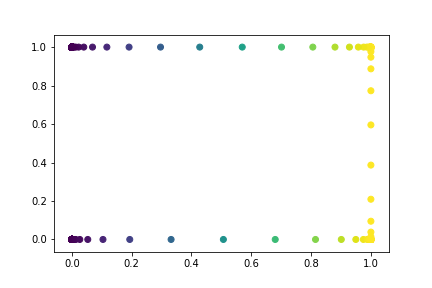

In [113]:
Image(filename='8Gaussianstsne-vae/8gaussians/manually/_epoch000.png') 

------

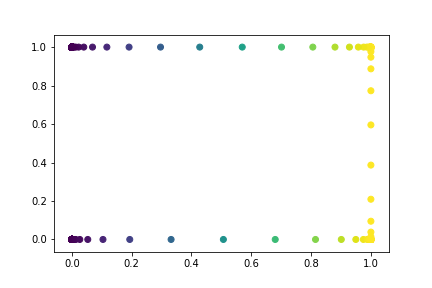

In [114]:
model = VAE()
model.load_state_dict(torch.load('8-gaussians.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-5,5,0.01):
        indexes.append([float(i)])
a=torch.randn(64,1)

samples=decode_given_z(torch.tensor(indexes),'8',int(np.sqrt(len(indexes))))

visualize_results(samples,[0]*len(indexes),'manually',9)

Image(filename='8Gaussianstsne-vae/8gaussians/manually/_epoch000.png') 

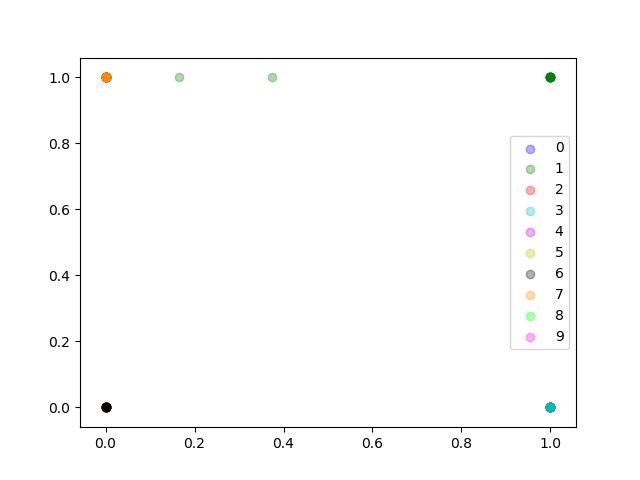

In [115]:
Image(filename='8Gaussianstsne-vae/8gaussians/test/_epoch100.png') 

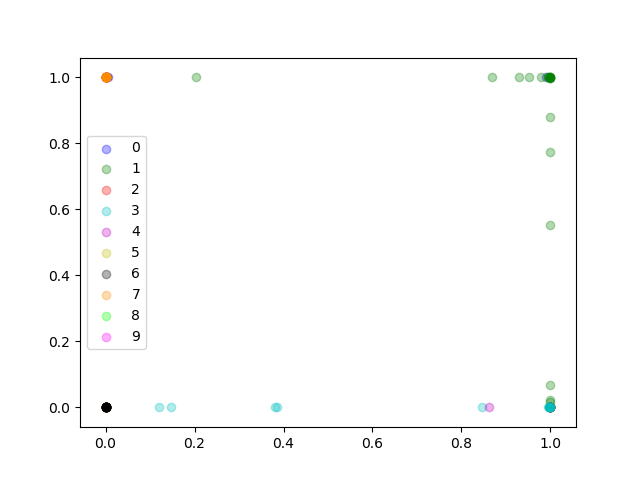

In [117]:
Image(filename='8Gaussianstsne-vae/8gaussians/test-l44/_epoch500.png') 

In [5]:
class autoencoder(nn.Module):
    def __init__(self):
        super(autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(2, 128),
            nn.ReLU(True),
            nn.Linear(128, 64),
            nn.ReLU(True), nn.Linear(64, 12), nn.ReLU(True), nn.Linear(12, 3))
        self.decoder = nn.Sequential(
            nn.Linear(3, 12),
            nn.ReLU(True),
            nn.Linear(12, 64),
            nn.ReLU(True),
            nn.Linear(64, 128),
            nn.ReLU(True), nn.Linear(128, 2), nn.Tanh())

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x


In [10]:
def ae_decode(z):
    with torch.no_grad():
        sample = z.to(device)
        sample = model.decoder(sample).cpu()
        return sample
        #save_image(sample.view(len(z), 1, 28, 28),'results/fashion-mnist/savedmodel_sample_'+name+'.png',nrow


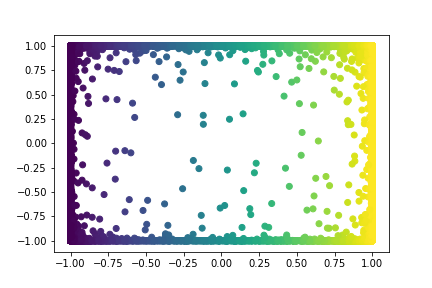

In [20]:
model = autoencoder()
model.load_state_dict(torch.load('sim_autoencoder.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-6,6,0.5):
    for j in np.arange(-6,6,0.5):
        for k in np.arange(-6,6,0.5):
            indexes.append([float(i),float(j),float(k)])
a=torch.randn(64,1)

 
samples=ae_decode(torch.tensor(indexes))

visualize_results(samples,[0]*len(indexes),'manually',9)

Image(filename='8Gaussianstsne-vae/8gaussians/manually/_epoch009.png') 

In [7]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_fewshot_missing.pt'))
device = torch.device("cpu")

In [25]:
indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

In [26]:
decode_given_z(torch.tensor(indexes),'boots',int(np.sqrt(len(indexes))))

tensor([[4.8686e-29, 4.0760e-18, 8.5696e-19,  ..., 4.1560e-39, 1.3097e-38,
         2.2055e-21],
        [1.2495e-28, 3.6446e-18, 7.4358e-19,  ..., 4.1560e-39, 1.3324e-38,
         1.6233e-21],
        [3.1889e-28, 3.2470e-18, 6.4533e-19,  ..., 4.1560e-39, 1.3633e-38,
         1.1903e-21],
        ...,
        [4.9226e-18, 1.6184e-14, 1.4215e-12,  ..., 7.0586e-16, 1.0576e-19,
         9.8495e-18],
        [1.7120e-18, 5.8433e-15, 3.1827e-13,  ..., 2.6311e-16, 4.3283e-20,
         4.0480e-18],
        [5.8325e-19, 2.0795e-15, 7.0207e-14,  ..., 9.7124e-17, 1.7622e-20,
         1.6134e-18]])

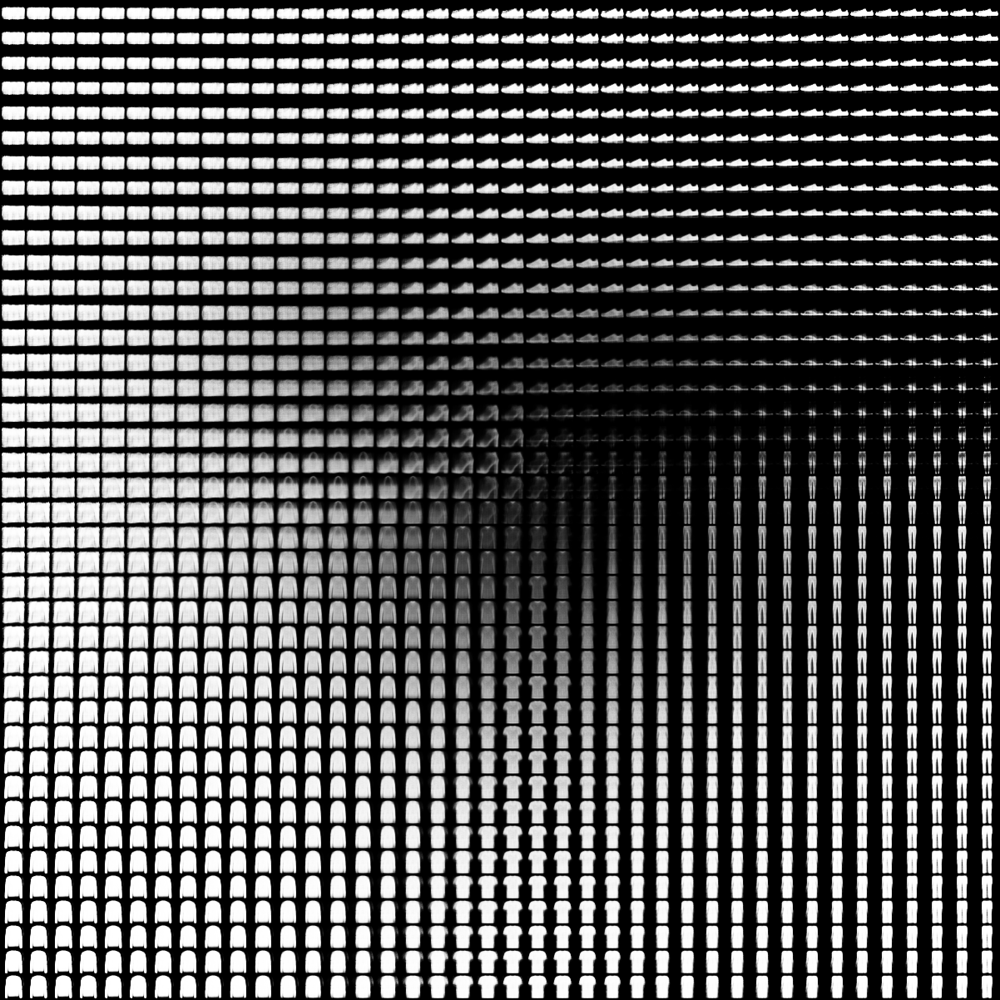

In [27]:
Image(filename='results/fashion-mnist/savedmodel_sample_boots.png') 

In [28]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_fewshot_missing_7.pt'))
device = torch.device("cpu")

In [37]:
indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

In [38]:
decode_given_z(torch.tensor(indexes),'sneakers',int(np.sqrt(len(indexes))))

tensor([[4.1405e-33, 7.7671e-15, 2.2361e-16,  ..., 6.7937e-38, 6.5915e-31,
         2.6938e-20],
        [2.2746e-32, 1.1462e-14, 3.5124e-16,  ..., 8.8216e-38, 8.3181e-31,
         2.8419e-20],
        [1.1946e-31, 1.5864e-14, 5.2809e-16,  ..., 1.1432e-37, 1.0478e-30,
         2.8809e-20],
        ...,
        [1.9862e-20, 8.0797e-11, 3.5729e-06,  ..., 1.3744e-08, 1.0511e-21,
         8.8840e-21],
        [3.1053e-21, 3.2786e-11, 1.0261e-06,  ..., 7.5212e-09, 1.1086e-22,
         1.1383e-21],
        [4.7118e-22, 1.2827e-11, 2.8520e-07,  ..., 3.9872e-09, 1.1508e-23,
         1.4368e-22]])

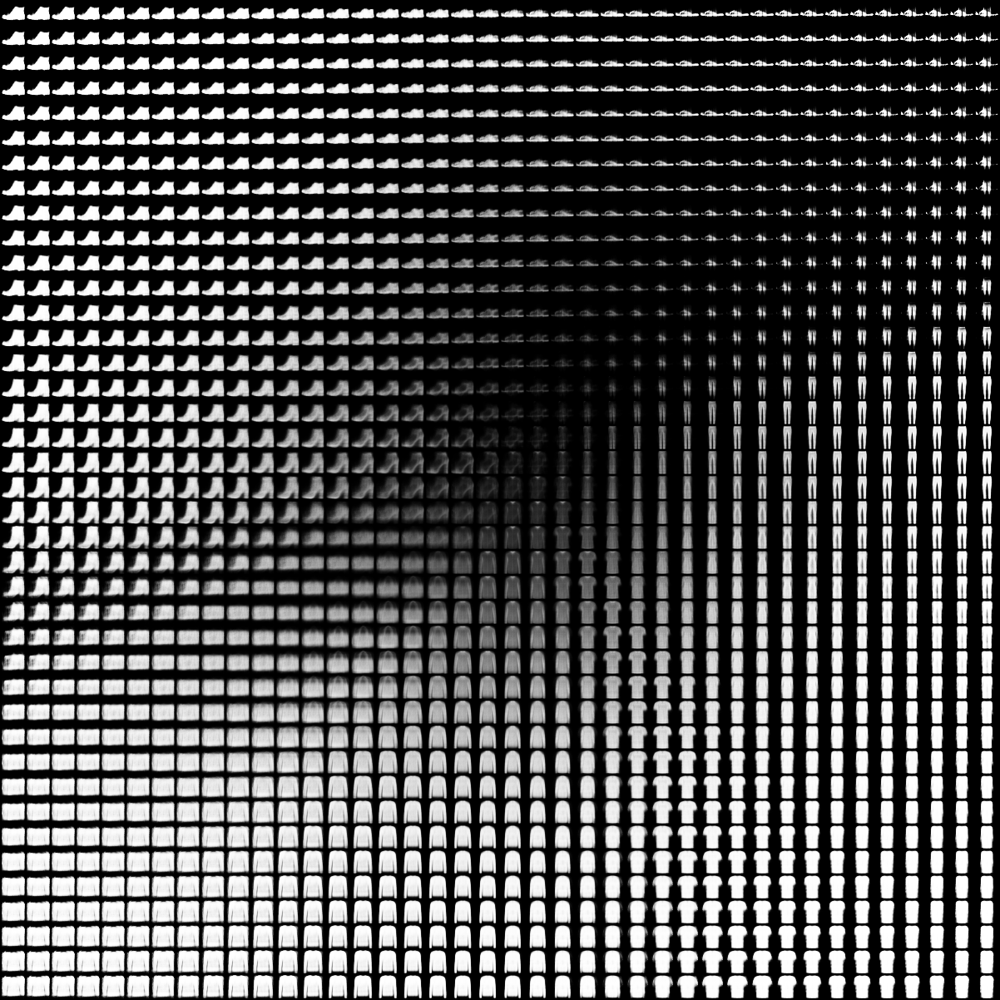

In [39]:
Image(filename='results/fashion-mnist/savedmodel_sample_sneakers.png') 

# No Pants

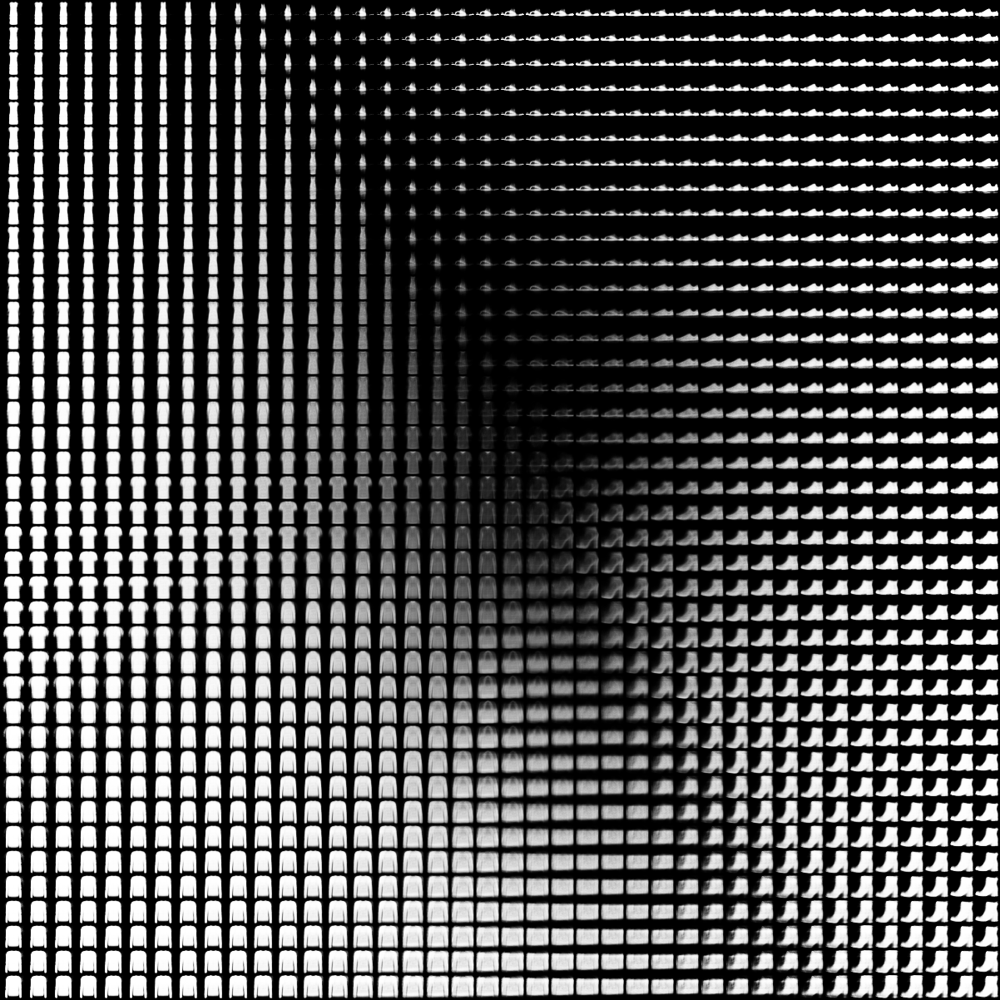

In [41]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_fewshot_missing_1.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'pants',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_pants.png') 

# 5 Pants

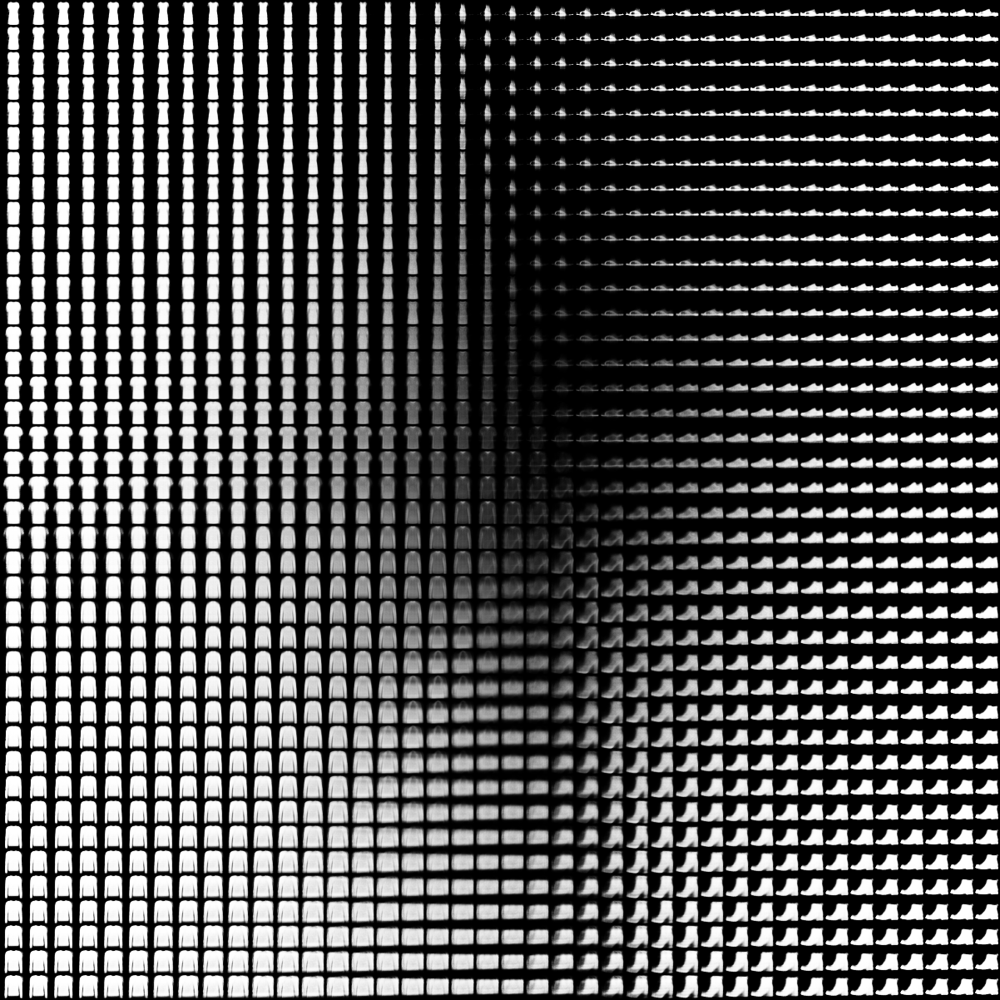

In [42]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_5shot_missing_1.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'pants_5',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_pants_5.png') 

# 5 Pants - repeated 

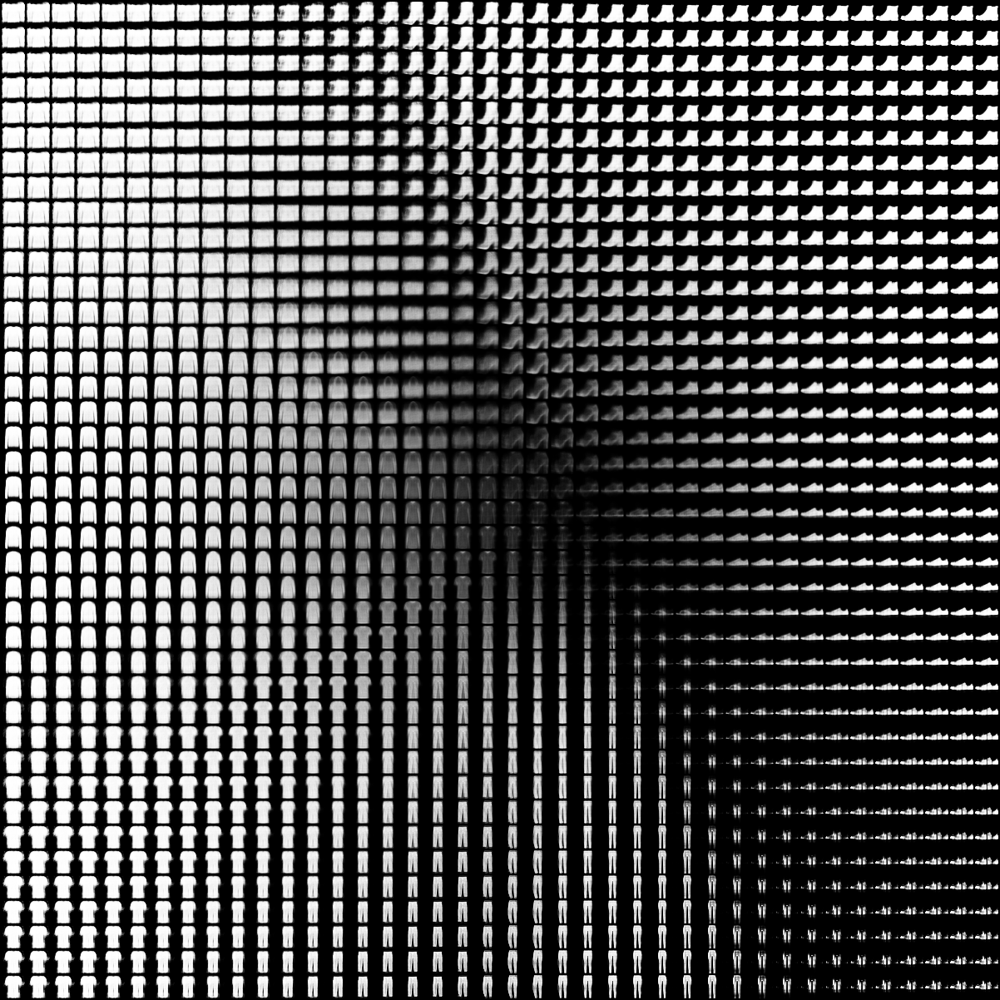

In [46]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_5shot_repeated_missing_1.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-4,4,0.2):
    for j in np.arange(-4,4,0.2):
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'pants_5',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_pants_5.png') 

# 1 Pants - repeated 

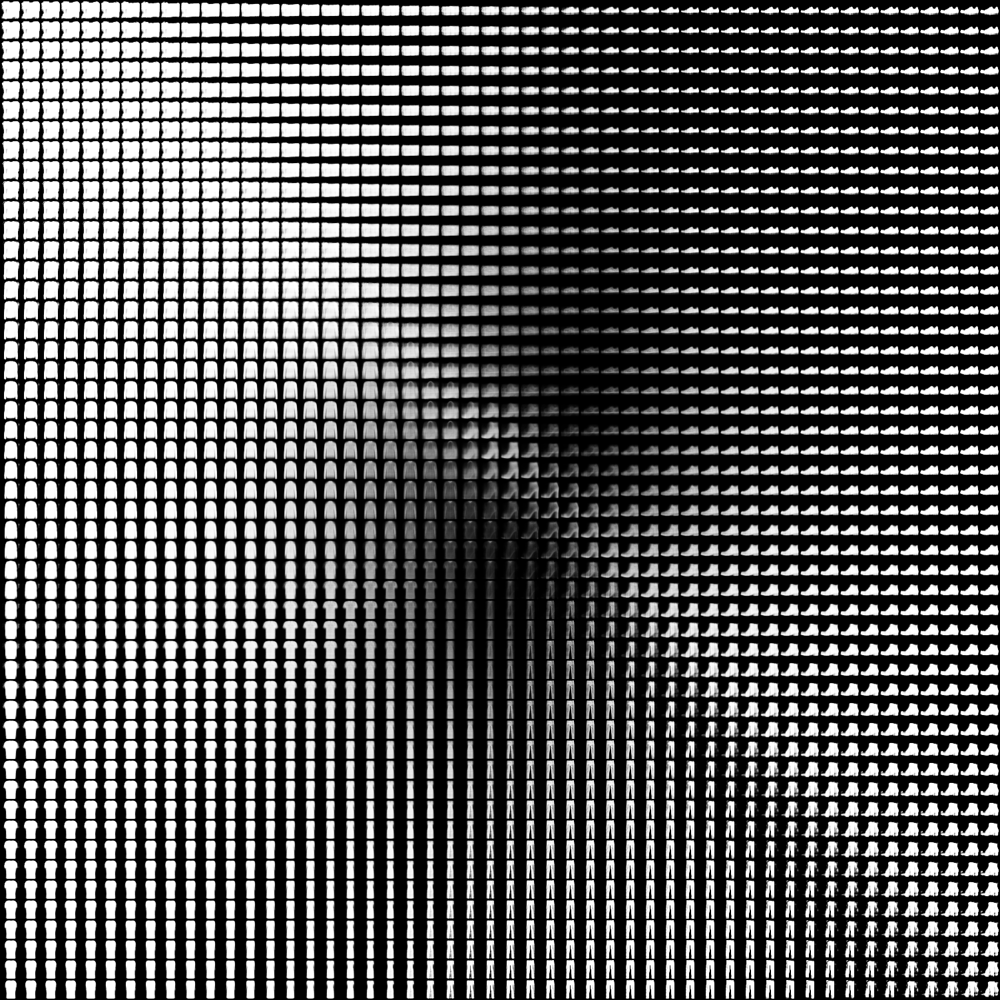

In [48]:
model = VAE()
model.load_state_dict(torch.load('model_trousers_1shot_repeated_missing_1.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-5,5,0.2):
    for j in np.arange(-5,5,0.2):
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'pants_5',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_pants_5.png') 

# 1 Pants - repeated - enc size 3

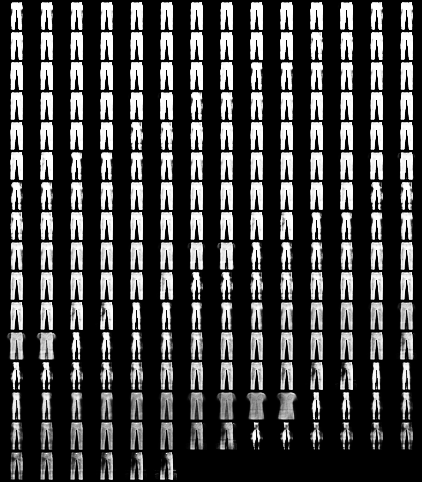

In [144]:
# 1 Pants - repeated 

model = VAE()
model.load_state_dict(torch.load('model_trousers_1shot_repeated_missing_vector3_1.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-4,-1,0.5):
    for j in np.arange(0.5,2,0.5):
        for k in np.arange(-4,2,0.5):    
            indexes.append([float(i),float(j),float(k)])

decode_given_z(torch.tensor(indexes),'pants_5_width',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_pants_5_width.png') 

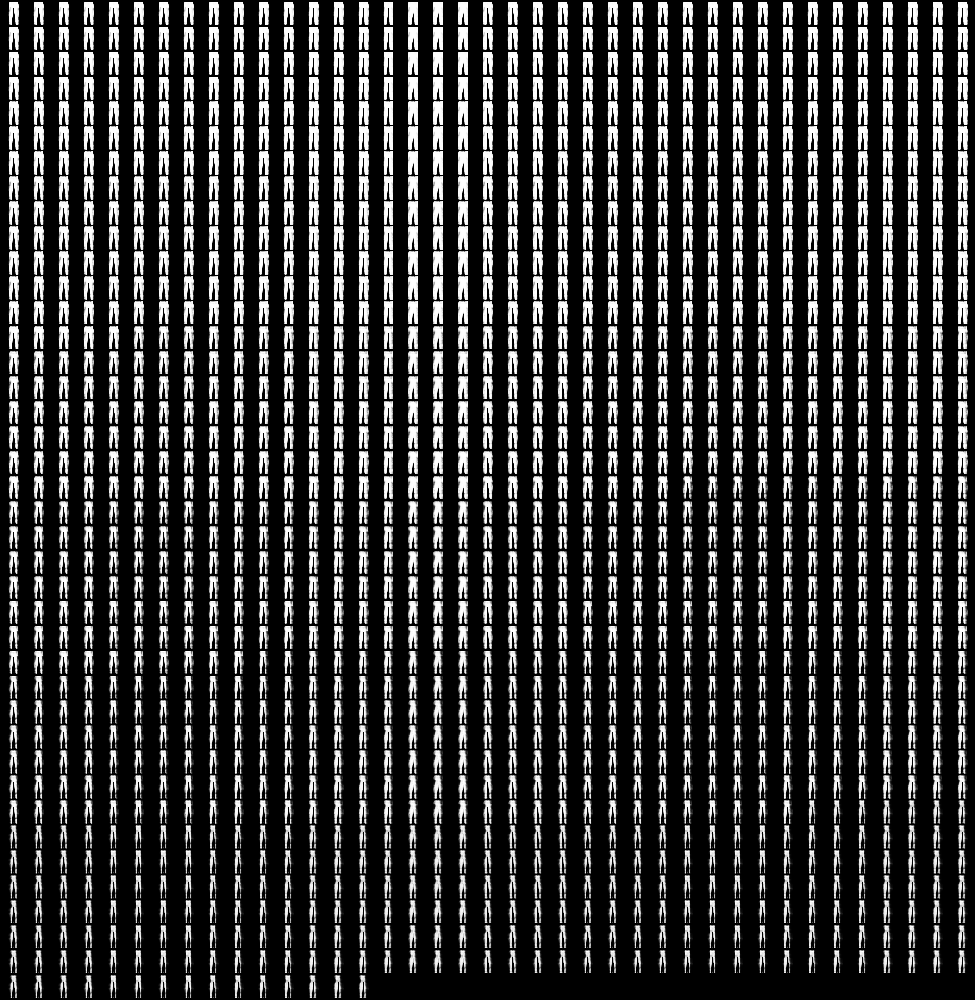

In [146]:
Image(filename='results/fashion-mnist/savedmodel_sample_pants_5.png') 

# mnist 9- repeated - enc size 3

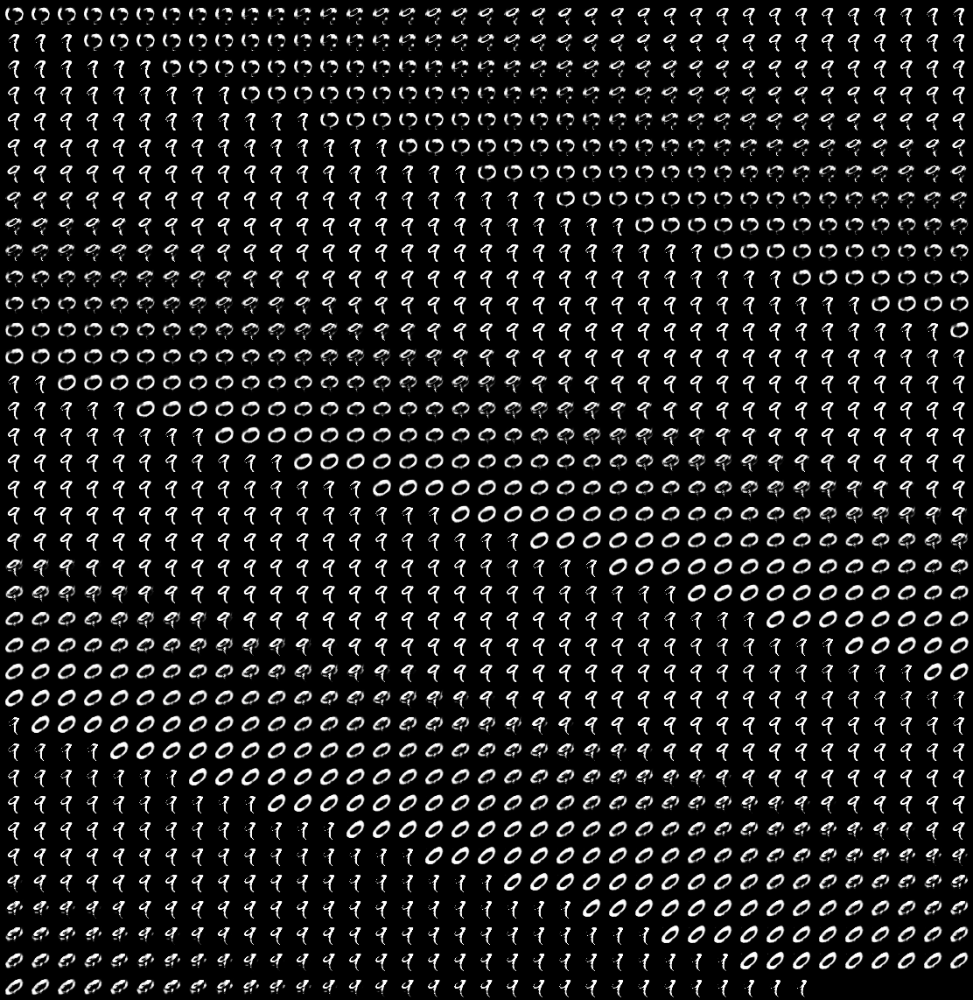

In [7]:
# 1 Pants - repeated 

model = VAE()
model.load_state_dict(torch.load('mnist_1shot_repeated_missing_vector3_9.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-4,3,0.2):
    for k in np.arange(-4,4,0.2):    
        indexes.append([float(i),float(3),float(k)])

decode_given_z(torch.tensor(indexes),'mnist_9',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_mnist_9.png') 

# mnist 9- repeated - enc size 2

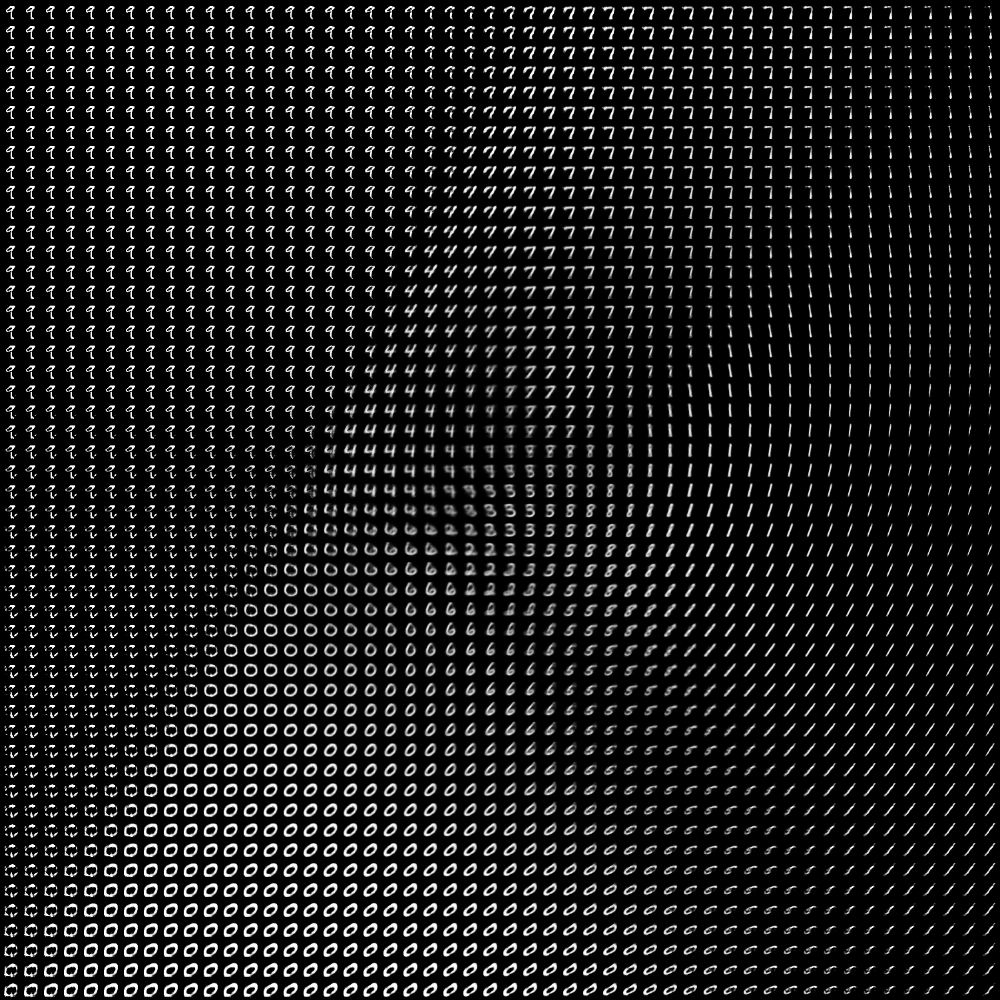

In [11]:
# 1 Pants - repeated 

model = VAE()
model.load_state_dict(torch.load('mnist_1shot_repeated_missing_vector2_9.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-5,5,0.2):
    for j in np.arange(-5,5,0.2):    
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'mnist_2vec_9',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_mnist_2vec_9.png') 

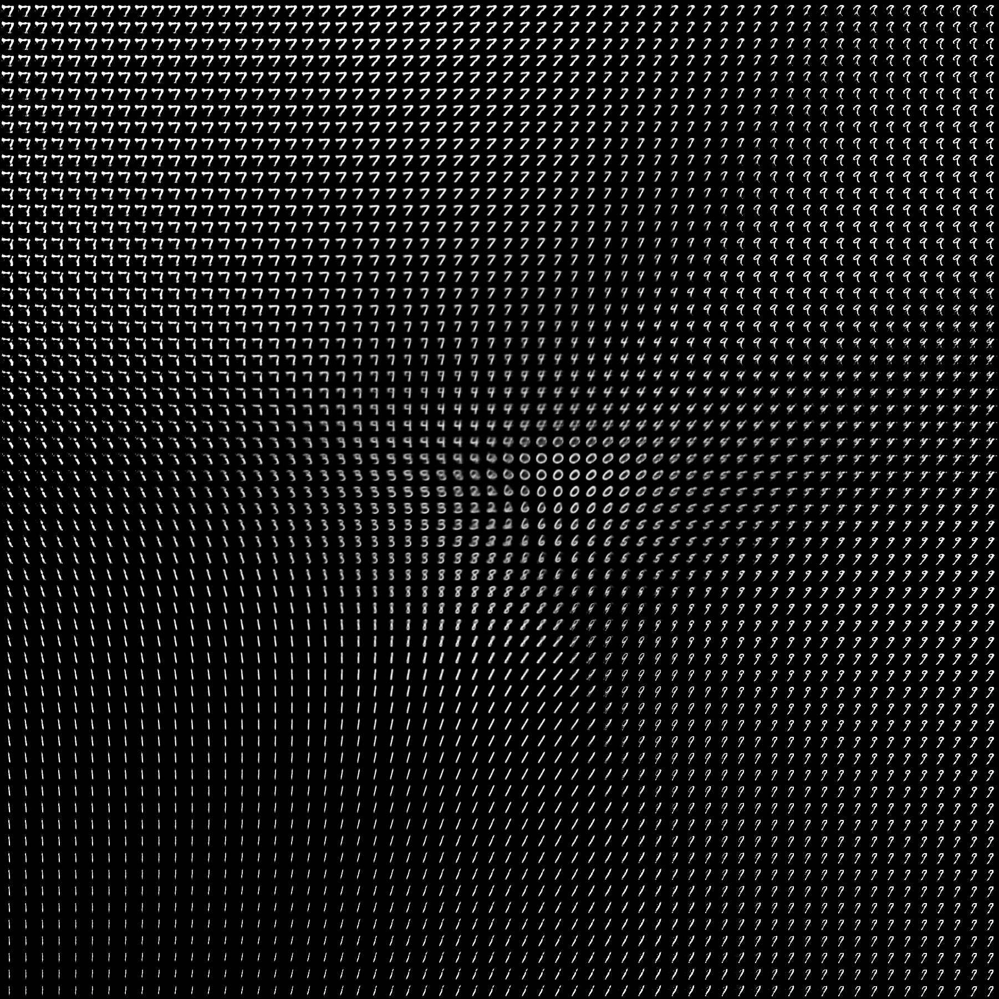

In [35]:
# 1 Pants - repeated 

model = VAE()
model.load_state_dict(torch.load('mnist_5shot_repeated_missing_vector2_9.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-6,6,0.2):
    for j in np.arange(-6,6,0.2):    
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'5shot-mnist_2vec_9',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_5shot-mnist_2vec_9.png') 

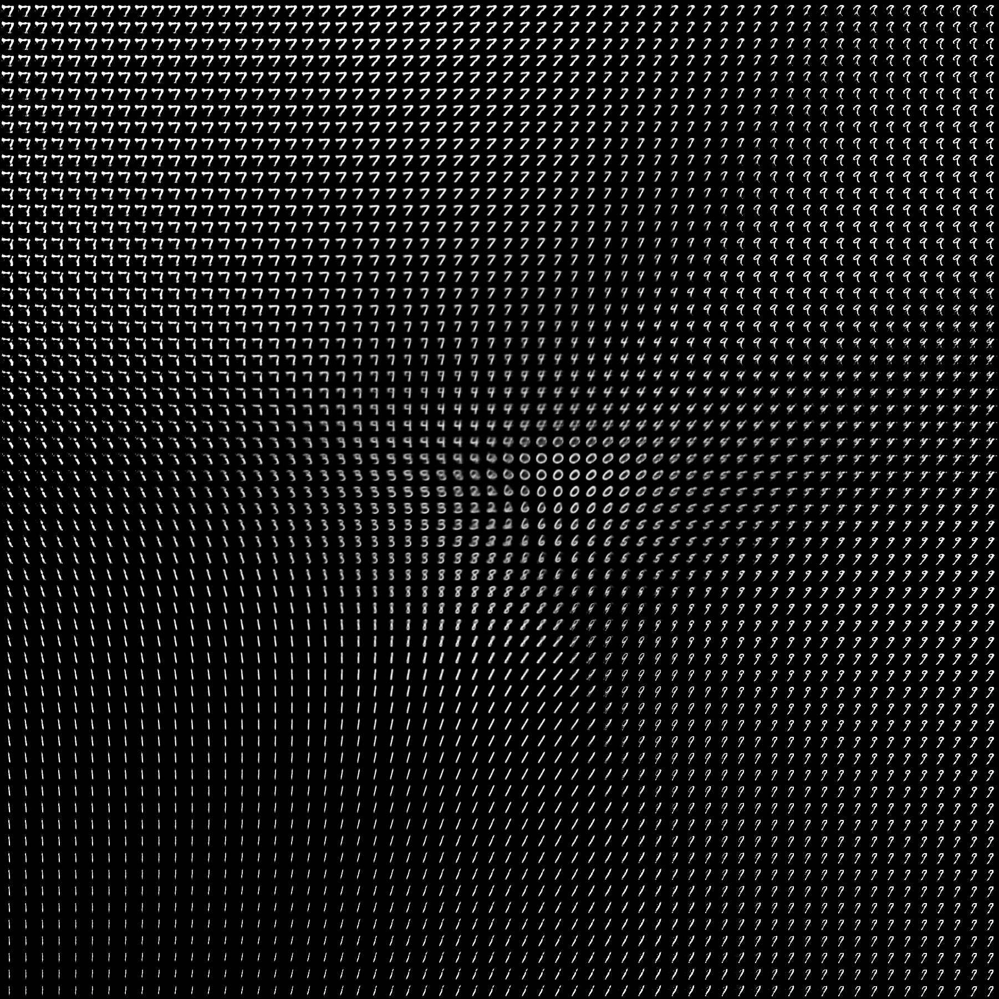

In [35]:
# 1 Pants - repeated 

model = VAE()
model.load_state_dict(torch.load('mnist_5shot_repeated_missing_vector2_9.pt'))
device = torch.device("cpu")

indexes=[]
for i in np.arange(-6,6,0.2):
    for j in np.arange(-6,6,0.2):    
        indexes.append([float(i),float(j)])

decode_given_z(torch.tensor(indexes),'5shot-mnist_2vec_9',int(np.sqrt(len(indexes))))

Image(filename='results/fashion-mnist/savedmodel_sample_5shot-mnist_2vec_9.png') 